### Spot segmentation pipeline and comparison with cellpose images
This spot segmentation tool can catch arbitrary small spots so the user need to take decision on the background vs. signal ratio. In addition, even if the spot is possible to detect with computer vision, it doesn't necessarily mean that it is biologically interesting. The latter may depend on the experiment set-up. Therefore, it could be interesting to make two models: One that segments all spots and one that classifies every spot as 'background' or 'interesting'. In that case we would have on segmentation model (that catches all spots) and one classification model (that separated the spots for this specific dataset). The pro with this approach is that we could try to analyse and describe the whole range of spots, while the con is that it may take a unecessary resources to segment spots that will anyway not be used by the biologists.

#### The preminilary pipeline for spot segmentation:
1. 2048*2048 pixels images are divided into patches: 512 pixels * 512 pixels + 20 pixels overlap at inner borders (since only closed contours are found with the spot detection tool, the spots touching border would otherwise be overlooked).
2. Image preprocessing: Tried erosion and deletion but since spots can be very small this seemed to cause some spots to disappear or background to become more spot-like. For now only gaussian blur has been used.
3. Spot detection: This version favors single peaks to be found, thus forcing the outer contours to be smaller than the spot in settings were several spots are clustered. The noise in the spot peak intensity could cause some spots to be disregarded, because the z distance from peak to outer contour becomes too small.
4. Sam is run with centroid from the spots as positive input point. No sam2 yet.
5. The sam results are filtered (size, contains input point or not) and merged with the outer contours of the detection tool. This way, the spots that are not caught by sam (which are usually the small ones that are not merged and therefore well found be detection tool) are included while the ones that are not fully segmented by detection tool are better covered by sam.
6. The images are used as input for fine-tuning sam2 tiny model. The images had to be even smaller to avoid runing into memory issues, tried with 50*50 pixels.
7. The model can be used to find spots, seems to work quite ok even though have only been trained on one full 2048*2048 pixels image and only for a 5 minute test run. 

In [2]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.path import Path
import matplotlib.patches as patches
import tifffile
from skimage import data, feature, color
from scipy.ndimage import grey_erosion, grey_dilation
import plotly.graph_objects as go
import pandas as pd
from segment_anything import SamPredictor, sam_model_registry
import tools
from spot_detection_tool import SpotDetector

from cellpose import models, plot, utils, io
from cellpose.io import imread

def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)
    
def show_points(coords, labels, ax, marker_size=10):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='o', s=marker_size)#, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='o', s=marker_size, edgecolor='white', linewidth=1.25)   
    
def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))    


def crop(image, x, y, height, width):
    cropped_image = image[y:y+height, x:x+width]
    return cropped_image

def tiff_to_array(tiff_path):
    with tifffile.TiffFile(tiff_path) as tiff:
        image = tiff.asarray() 
    return image
    
def convert_to_8bit(image_16):
    max_value = image_16.max() # normalize with recpect to max value
    min_value = image_16.min() # clip values below min
    #threshold = min_value+100
    #clipped_image = np.where(image_16 <= threshold, threshold, image_16)
    #image_8 = (255.0 * image_16 / (max_value - threshold)).astype(np.uint8)
    #image_8 = ((image_16-min_value)/max_value*255).astype('uint8')
    image_8 = (255.0 * (image_16 - min_value) / (max_value - min_value)).astype(np.uint8)
    return image_8

def plotly_3d_features(image, mask):     
        # make grid for plotting
        x = np.linspace(0, image.shape[1] - 1, image.shape[1])
        y = np.linspace(0, image.shape[0] - 1, image.shape[0])
        x, y = np.meshgrid(x, y)
        points = np.vstack((x.ravel(), y.ravel())).T

        # Create the surface plot for the image
        fig = go.Figure(go.Surface(
            z=image,
            surfacecolor=image,  # Using the image data itself for coloring
            colorscale='gray',   # The primary color scheme
        ))

        # Add overlay using the mask
        masked_data = np.where(mask, image, np.nan)  # Set unmasked areas to NaN
        fig.add_trace(go.Surface(
            z=masked_data,# + 0.01,  # Add a small elevation to avoid z-fighting
            showscale=False            # Do not show the scale for the mask
        ))

        # Update layout to make the z-axis appear flatter
        fig.update_layout(
            title='Masked spot',
            scene=dict(
                xaxis=dict(title='X Axis'),
                yaxis=dict(title='Y Axis'),
                zaxis=dict(title='Intensity', range=[np.min(image), np.max(image)]),  # Adjusting range
                aspectratio=dict(x=1, y=1, z=0.2),  # Flattening the z-axis
            ),
            width=1200,  # Width of the figure
            height=800  # Height of the figure
        )

        fig.show()

def plot_spots(self):     
        spots = self.get_base()
        plt.rcParams['figure.figsize'] = [10, 5] 
        fig, axes = plt.subplots(nrows=1, ncols=2, constrained_layout=True)
        axes[0].imshow(self.image, cmap = 'gray')
        axes[1].imshow(self.image, cmap = 'gray')

        for key in spots.keys():
            path = spots[key]['path']
            patch = patches.PathPatch(path, edgecolor='orange', fill=False, lw=1)
            axes[1].add_patch(patch)
        plt.show()

def get_bbox(path):
    # Get the extents of the path
    bounds = path.get_extents()
    # Add padding
    pad = 0
    # Extract the coordinates in xyxy format
    x_min, y_min = bounds.min
    x_max, y_max = bounds.max
    bbox = (x_min-pad, 
            y_min-pad, 
            x_max+pad, 
            y_max+pad)
    return bbox

def find_resets(lst):
    resets = []
    for i in range(1, len(lst)):
        # Detect a reset
        if lst[i] < lst[i-1]:
            resets.append(i-1)
    return resets

# Function to create a circular structuring element
def circular_kernel(radius):
    L = 2 * radius + 1
    kernel = np.zeros((L, L), dtype=np.uint8)
    center = radius
    for i in range(L):
        for j in range(L):
            if (i - center) ** 2 + (j - center) ** 2 <= radius ** 2:
                kernel[i, j] = 1
    return kernel

#### Intensity Landscape
The grayscale image can be thought of as a 2D surface where the intensity values of the pixels represent the height of the landscape. For the Atg8 fluorescence microscopy images, the darker pixels would correspond to valleys of low Atg8 concentration while brighter pixels would correpond to peaks of high Atg8a concentration that could be interpreted as autophagic vesicles. Thus, we can borrow some concepts from topography such as topographic isolation and prominence to chategorize the atg8a spots.

In topography, the prominence is defined as the height difference between the peak itself and the lowest point that it needs to pass to get to higher terrain. For the Atg8 peaks, this correspond to the smallest concentration decrease between a peak and a greater neighbor. When the concentration does not lower significantly between two peaks, they may be considered as belonging to the same peak. When counting Atg8 peaks, there will inevitably be peaks that cannot be separated in a meaningful way and therefore should be merged. One reason is that the cells are 3D objects where the autophagosomes may be overlapping in z direction. Also, the overlapping light (in x,y plane) that results from vesicles being close to each other will make make them merge at a given intensity. Prominence could therefore be used as a decesive parameter for peak merging.

The topographic isolation, on the other hand, is the closest point of equal z value. For closely spaced peaks, the isolation point could maybe be used to generate bounding boxes?

Images below are from wikipedia: https://en.wikipedia.org/wiki/Topographic_prominence

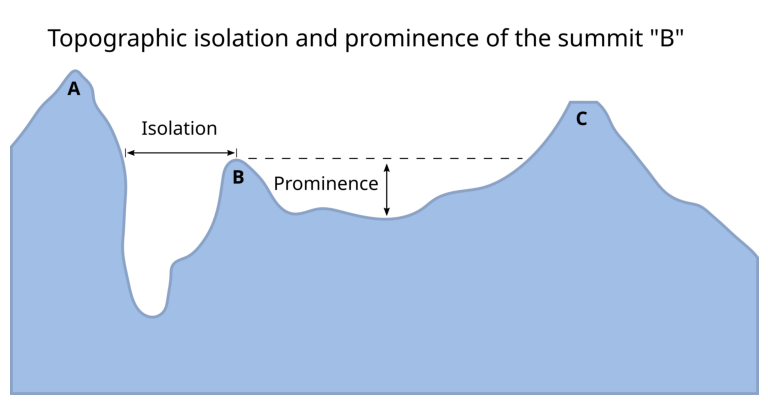

In [74]:
plt.figure()
prominence_img = cv2.imread('Topographic_isolation_and_prominence.png')
plt.axis('off')
plt.imshow(prominence_img)

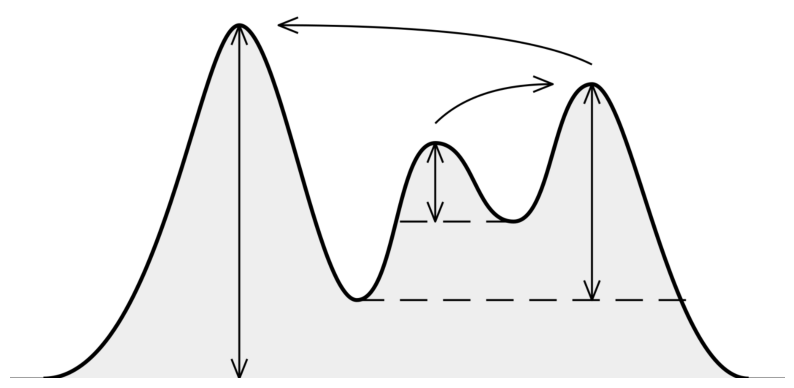

In [75]:
#prominence_img = 'Prominence_definition.png'

plt.figure()
prominence_img = cv2.imread('Prominence_definition.png')
plt.axis('off')
plt.imshow(prominence_img)

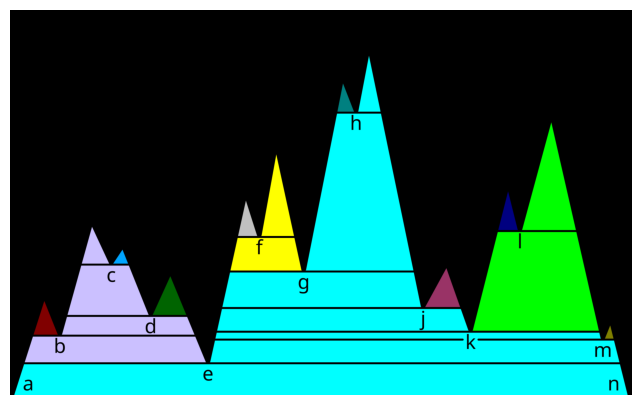

In [76]:
#prominence_img = 'Prominence_definition.png'

plt.figure()
prominence_img = cv2.imread('ProminenceDiagram.png')
plt.axis('off')
plt.imshow(prominence_img)

#### Just a test image to see the 'Intesity Landscape'

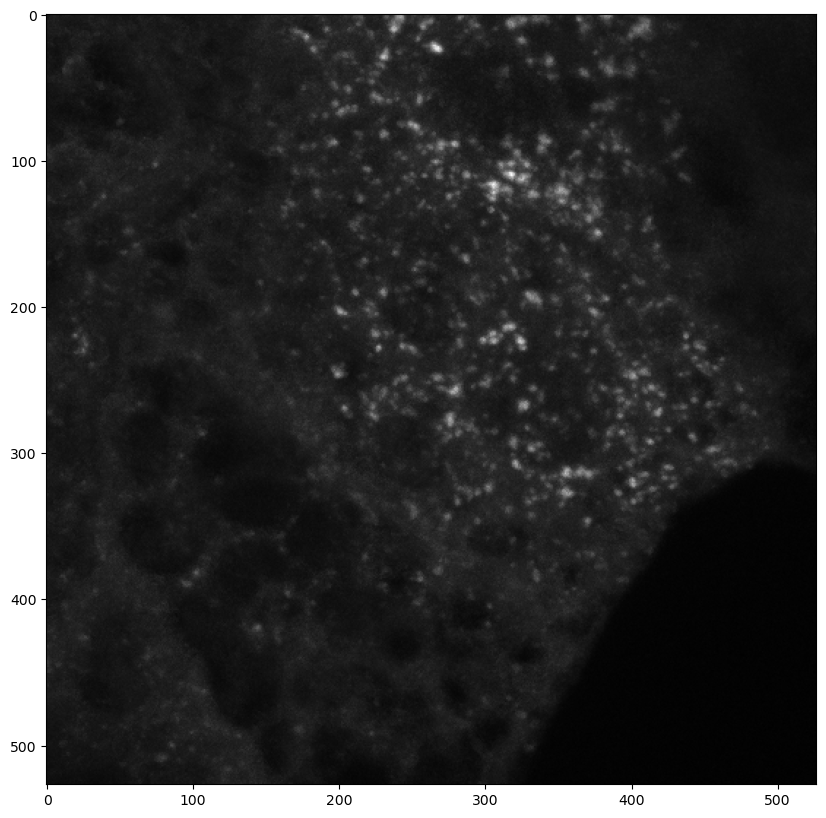

In [3]:
# get training image
start_x = 2
start_y = 2
image_name = f'MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x{start_x}_y{start_y}.tiff'
image_path = 'finetuning/images/' + image_name
img = tiff_to_array(image_path)
plt.figure(figsize = (10,10))
plt.imshow(img, cmap = 'gray')

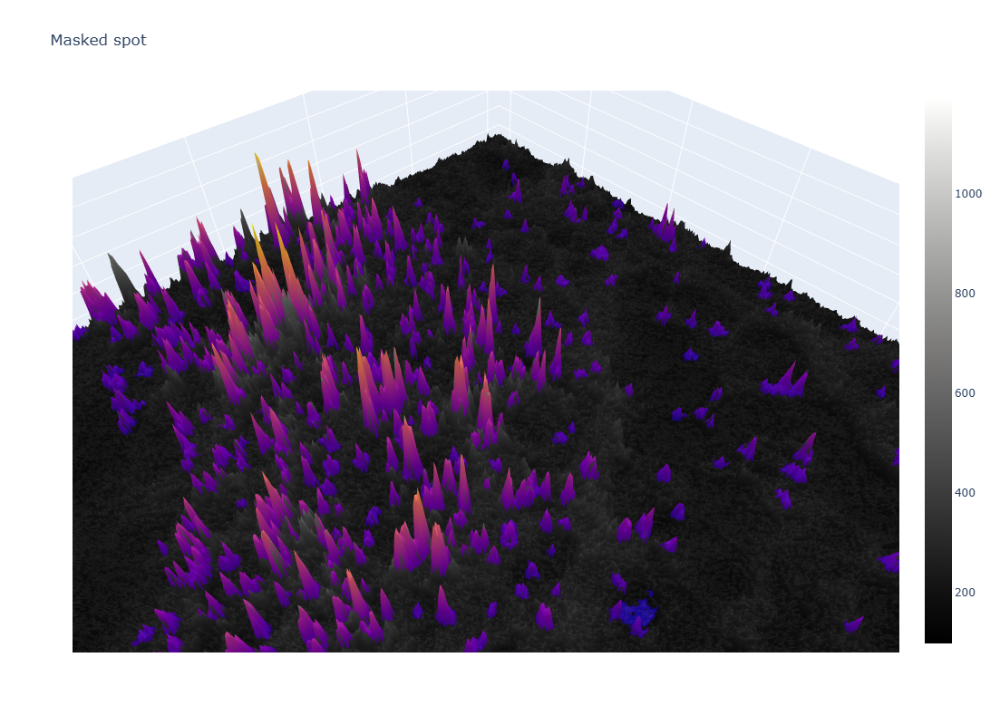

In [87]:
masks_name = 'finetuning/masks/' + image_name[:-5] + '_masks.png'
masks = cv2.imread(masks_name)

plotly_3d_features(img, masks[:,:,1])

#### The full pipeline for a given patch:

Text(0.5, 1.0, 'erosion+dilation')

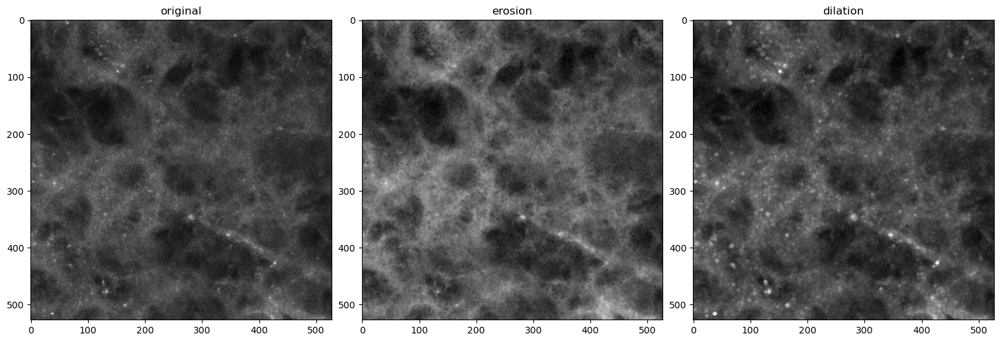

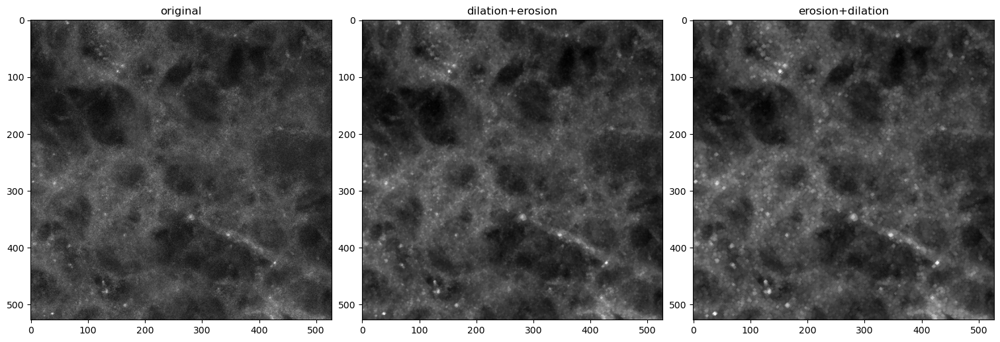

In [4]:
# Test different pre-processing

# Create a circular kernel with a radius of 1
kernel1 = 1
kernel2 = 2
circular_1 = circular_kernel(kernel1)
circular_2 = circular_kernel(kernel2)

# Perform erosion
eroded_image = grey_erosion(img, footprint=circular_2)

# Perform dilation
dilated_image = grey_dilation(img, footprint=circular_2)

plt.rcParams['figure.figsize'] = [15, 5] 
fig, axes = plt.subplots(nrows=1, ncols=3, constrained_layout=True)

axes[0].imshow(img, cmap = 'gray')
axes[1].imshow(eroded_image, cmap = 'gray')
axes[2].imshow(dilated_image, cmap = 'gray')
axes[0].set_title('original')
axes[1].set_title('erosion')
axes[2].set_title('dilation')

# Perform erosion
eroded_image = grey_erosion(dilated_image, footprint=circular_1)

# Perform dilation
dilated_image = grey_dilation(eroded_image, footprint=circular_1)


plt.rcParams['figure.figsize'] = [15, 5] 
fig, axes = plt.subplots(nrows=1, ncols=3, constrained_layout=True)

axes[0].imshow(img, cmap = 'gray')
axes[1].imshow(eroded_image, cmap = 'gray')
axes[2].imshow(dilated_image, cmap = 'gray')
axes[0].set_title('original')
axes[1].set_title('dilation+erosion')
axes[2].set_title('erosion+dilation')



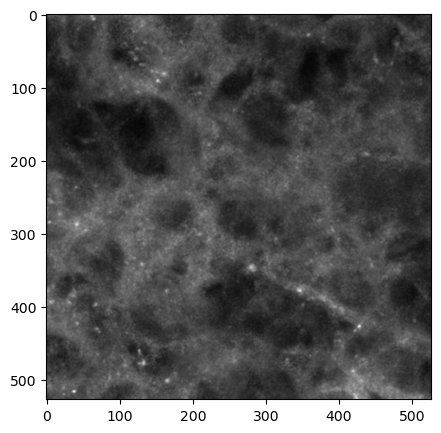

In [78]:
# Choose image
#img = eroded_image
blur = 3
img = cv2.GaussianBlur(img, (blur, blur), 0)
plt.imshow(img, cmap='gray')

There are 16804 contours


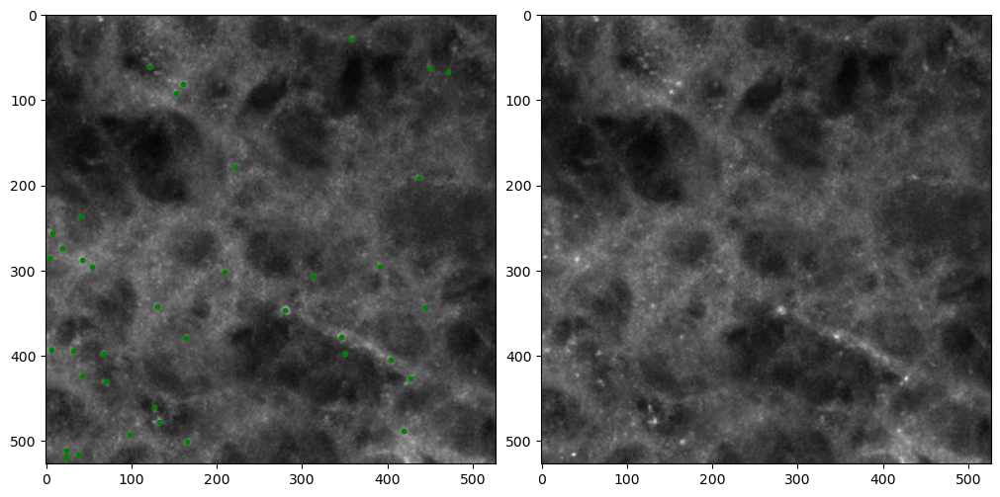

In [79]:
#img = img_3d[:,:,1]
min_area= 3
max_area= 200
levels = 150
min_z = 25
spots=SpotDetector(img,contour_levels=levels, min_area=min_area, max_area=max_area,min_circularity = 0.3, z_min_dist = min_z)
all_dict=spots.get_features()
feature_dict = spots.check_z_distance(all_dict)
plt.close()


count = 0
plt.rcParams['figure.figsize'] = [10, 20] 
fig, axes = plt.subplots(nrows=1, ncols=2, constrained_layout=True)
axes[0].imshow(img, cmap = 'gray')
axes[1].imshow(img, cmap = 'gray')


for feature_nb in feature_dict:
    max_level = len(feature_dict[feature_nb])-1
    local_features = {}

    # not a good way to look for local maxima but does the job on well sorted level lists
    levels = []
    for i in feature_dict[feature_nb]:
        levels.append(feature_dict[feature_nb][i]['level'])

    resets = find_resets(levels)
    local_points = []
    
    for i in resets:
        local_points.append(feature_dict[feature_nb][i]['centroid'])
        
    local_points.append(feature_dict[feature_nb][max_level]['centroid'])
    path= feature_dict[feature_nb][0]['path']
    input_box = np.array(get_bbox(path))

    if len(local_points)>1:
        input_point = np.array(local_points)
        local_labels = np.ones(len(local_points))
        input_label = local_labels

    else:
        input_point = np.array([feature_dict[feature_nb][max_level]['centroid']])
        input_label = np.array([1])

    show_points(input_point, input_label,axes[0] ) # plt.gca())


start range: 209
end range: 209


Text(0.5, 1.0, 'clipped image')

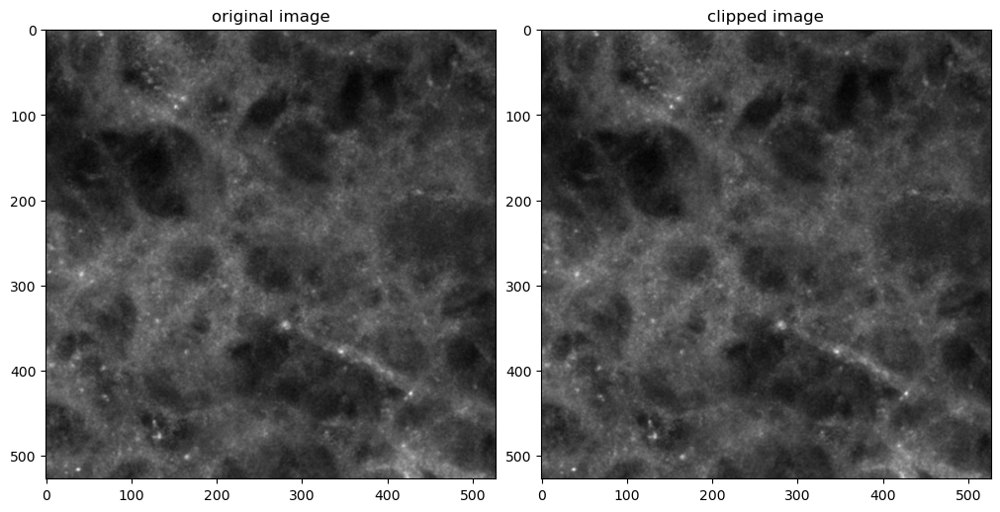

In [80]:
def convert_to_8bit(image_16):
    max_value = image_16.max() # normalize with recpect to max value
    min_value = image_16.min() # clip values below min
    print(f'start range: {max_value-min_value}')
    threshold = min_value+0
    max_threshold = max_value - 0
    clipped_min = np.where(image_16 <= threshold, threshold, image_16)
    clipped_max = np.where(clipped_min >= max_threshold, max_threshold, clipped_min)
    print(f'end range: {clipped_max.max()-clipped_max.min()}')

    image_8 = (255.0 * (clipped_max- clipped_max.min()) / (clipped_max.max() - clipped_max.min())).astype(np.uint8)
    #image_8 = ((image_16-min_value)/max_value*255).astype('uint8')
    #image_8 = (255.0 * (image_16 - min_value) / (max_value - min_value)).astype(np.uint8)
    
    return image_8

#Convert to 8 bit for using with sam
img_8bit= convert_to_8bit(img)
img_3d = np.stack((img_8bit, img_8bit, img_8bit), axis=-1)
plt.rcParams['figure.figsize'] = [10, 20] 
fig, axes = plt.subplots(nrows=1, ncols=2, constrained_layout=True)
axes[0].imshow(img, cmap = 'gray')
axes[1].imshow(img_3d, cmap = 'gray')
axes[0].set_title('original image')
axes[1].set_title('clipped image')


In [81]:
# Get sam embedding

sam = sam_model_registry["vit_l"](checkpoint="sam_vit_l_0b3195.pth")
predictor = SamPredictor(sam)
predictor.set_image(img_3d)

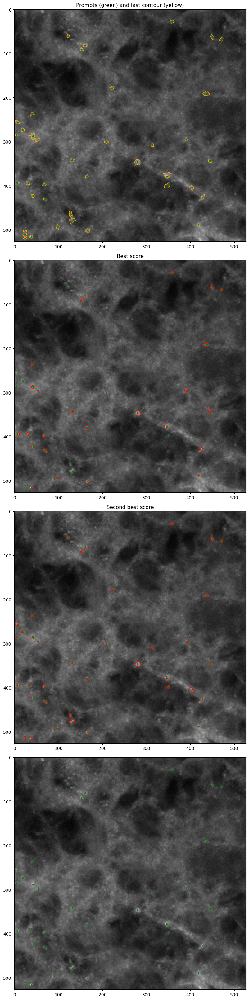

In [82]:
img = img_3d
# Get sam masks and merge them with detection tool
mask = np.zeros(img.shape, dtype=bool)
mask = np.zeros(img.shape) #, dtype=bool)
count = 0
plt.rcParams['figure.figsize'] = [8, 32] 
fig, axes = plt.subplots(nrows=4, ncols=1, constrained_layout=True)
axes[0].imshow(img, cmap = 'gray')
axes[1].imshow(img, cmap = 'gray')
axes[2].imshow(img, cmap = 'gray')
axes[3].imshow(img, cmap = 'gray')

min_area_sam = 3
max_area_sam = 150

for feature_nb in feature_dict:
    max_level = len(feature_dict[feature_nb])-1
    local_features = {}

    # not a good way to look for local maxima but does the job on well sorted level lists
    levels = []
    for i in feature_dict[feature_nb]:
        levels.append(feature_dict[feature_nb][i]['level'])

    resets = find_resets(levels)
    local_points = []
    
    for i in resets:
        local_points.append(feature_dict[feature_nb][i]['centroid'])
        
    local_points.append(feature_dict[feature_nb][max_level]['centroid'])
    path= feature_dict[feature_nb][0]['path']
    input_box = np.array(get_bbox(path))

    # get negative points and map them to the labels
    # dist = 0
    # p1 = np.array([input_box[0]- dist, input_box[1]- dist])
    # p2 =  np.array([input_box[2]+ dist, input_box[3]+ dist])
    # p3 =  np.array([input_box[0]- dist, input_box[3]+ dist])
    # p4 =  np.array([input_box[2]+ dist, input_box[1]- dist])

    if len(local_points)>1:
        # with neg points
        #input_point = np.concatenate((np.array(local_points) , np.array([ p1, p2, p3, p4]))) 
        #input_label = np.concatenate((local_labels , np.array([0, 0, 0, 0])))
        # without neg points
        input_point = np.array(local_points)
        local_labels = np.ones(len(local_points))
        
        # test without neg points
        input_label = local_labels

    else:
        #input_point = np.array([feature_dict[feature_nb][max_level]['centroid'], p1, p2, p3, p4])
        input_point = np.array([feature_dict[feature_nb][max_level]['centroid']])
        #input_label = np.array([1, 0, 0, 0, 0])
        input_label = np.array([1])

    #Use plt patches to draw contours of base contour 
    patch = patches.PathPatch(path, edgecolor='orange', fill=False, lw=1)
    axes[0].add_patch(patch)
    axes[0].set_title('Prompts (green) and last contour (yellow)')
    vertices = path.vertices
    mask = cv2.fillPoly(mask, np.int32([vertices]), 255)
    
    
    show_points(input_point, input_label,axes[0] )
    show_points(input_point, input_label,axes[1] )
    show_points(input_point, input_label,axes[2] )
    show_points(input_point, input_label,axes[3] )
    #show_box(input_box, axes[0] ) #plt.gca())

    new_mask, scores, logits = predictor.predict(
        point_coords=input_point,
        point_labels=input_label,
        #mask_input=input_box,
        multimask_output=True,
    )
    
    # Plot contours of mask
    score_1 = np.uint8(new_mask[0,:,:]*1)
    contours, _ = cv2.findContours(score_1, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        continue
    contour = contours[0].squeeze()
    #if  1 < contour.shape[0] <25 :
    #if contour.ndim >= 2 and contour.shape[1] < 25:
    if contour.ndim >= 2 and min_area_sam < cv2.contourArea(contours[0]) < max_area_sam:
        contour = np.vstack([contour, contour[0]])
        if cv2.pointPolygonTest(contour, local_points[0], measureDist=False) > 0:
            
            axes[1].plot(contour[:, 0], contour[:, 1], 'r-', linewidth=1)
            axes[1].set_title('Best score')
            mask = cv2.fillPoly(mask, [contour], 255)


    score_2 = np.uint8(new_mask[1,:,:]*1)
    contours, _ = cv2.findContours(score_2, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        continue

    contour = contours[0].squeeze()

    #if contour[1].shape ==(2,):   
    if contour.ndim >= 2 and min_area_sam < cv2.contourArea(contours[0]) < max_area_sam:
        if cv2.pointPolygonTest(contour, local_points[0], measureDist=False) > 0:
            #contour = contours[0].squeeze()
            contour = np.vstack([contour, contour[0]])
            axes[2].plot(contour[:, 0], contour[:, 1], 'r-', linewidth=1)
            axes[2].set_title('Second best score')
            mask = cv2.fillPoly(mask, [contour], 255)
            #show_mask(score_2, axes[2], random_color=False)
        # else: 
        #     print(f'excluding contour: {contour}')

    score_3 = np.uint8(new_mask[2,:,:]*1)
    contours, _ = cv2.findContours(score_3, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        continue
    contour = contours[0].squeeze()
    
    if contour.ndim >= 2 and min_area_sam < cv2.contourArea(contours[0]) < max_area_sam:
        if cv2.pointPolygonTest(contour, local_points[0], measureDist=False) > 0:
            contour = contours[0].squeeze()
            
        #if contour.ndim >= 2 and contour.shape[1] < 25:
            contour = np.vstack([contour, contour[0]]) # close contours
            axes[3].plot(contour[:, 0], contour[:, 1], 'r-', linewidth=1)
            axes[3].set_title('Third best score')
            mask = cv2.fillPoly(mask, [contour], 255)

    # = mask + new_mask

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


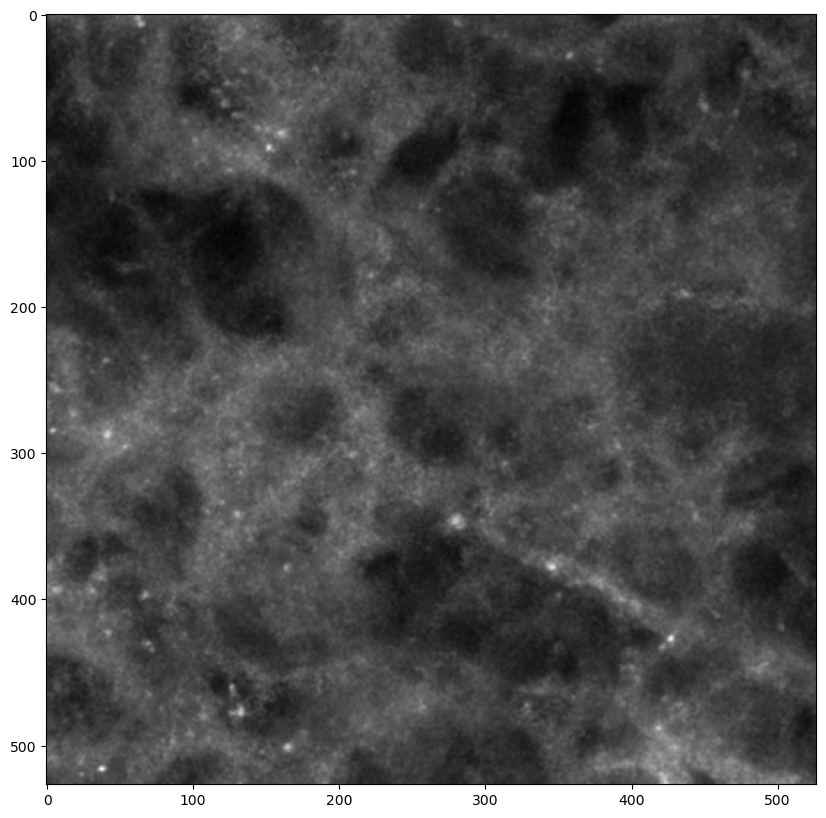

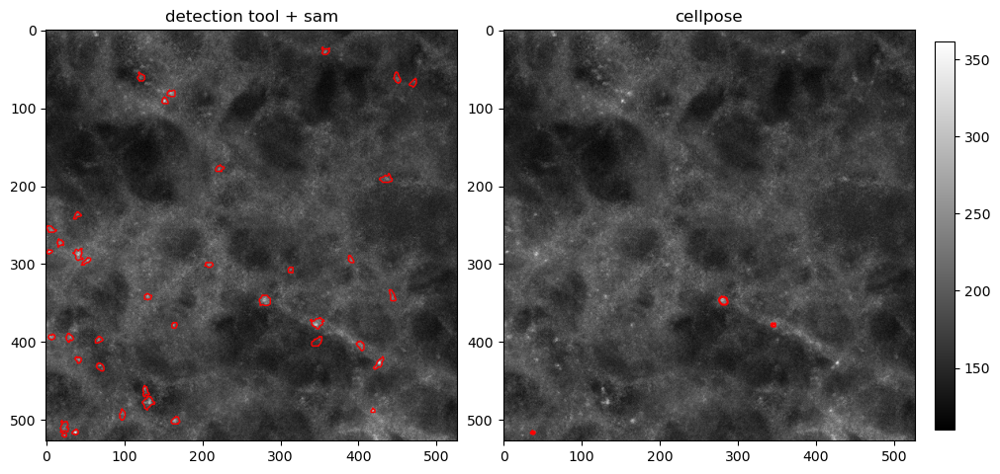

True

In [83]:
#sometimes needed:
mask=mask[:,:,0]

# plot cellpose
cwd = os.getcwd()
folder_path = cwd + "/cellpose_siri/" 
vmax_factor = 0.2

image_name = 'MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif'
file_path = folder_path + image_name

img_cellpose = io.imread(file_path)
# img = img[:,:,0]
# x_start = img.shape[0] *start_x- 20*2
# y_start = img.shape[0] *start_y -20*2

x_start = img.shape[0] *start_y- 20*start_y
y_start = img.shape[0] *start_x -20*start_x

img_cellpose_cropped = img_cellpose[x_start:x_start+img.shape[0], y_start:y_start +img.shape[0]]
dat_path = file_path[:-4] + '_seg.npy'
dat = np.load(dat_path, allow_pickle=True).item()
# plot image with masks overlaid
mask_RGB = plot.mask_overlay(img_cellpose[:,:,1], dat['masks'],
                        colors=np.array(dat['colors']))

# plot image with outlines overlaid in red
dat_cropped = dat['masks'][x_start:x_start+img.shape[0],y_start :y_start+img.shape[0]]
outlines = utils.outlines_list(dat_cropped)

# plot 
plt.rcParams['figure.figsize'] = [10, 10] 
plt.imshow(img, cmap='gray')

plt.rcParams['figure.figsize'] = [10, 5] 
fig, axes = plt.subplots(nrows=1, ncols=2, constrained_layout=True)
max_red = np.max(img_cellpose)

im1 = axes[0].imshow(img_cellpose_cropped[:,:,1], cmap='gray', )
contours, _ = cv2.findContours(np.uint8(mask), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
for contour in contours:
    contour = contour.squeeze()
    contour = np.vstack([contour, contour[0]]) # close contours
    axes[0].plot(contour[:, 0], contour[:, 1], 'r-', linewidth=1)


for o in outlines: 
    #plt.plot(o[:,0], o[:,1], color='r')
    axes[1].plot(o[:,0], o[:,1], color='r')
im2 = axes[1].imshow(img_cellpose_cropped[:,:,1], cmap='gray')
cbar = fig.colorbar(im1, ax=axes[1], shrink = 0.8)

axes[0].set_title('detection tool + sam')
axes[1].set_title('Siri's cellpose segmentation')
plt.show()
cv2.imwrite("test_mask.png", mask) 



In [ ]:
# save mask image
save_name = 'patches/masks/' + image_name[:-4] + f'_x{start_x}_y{start_y}_masks.png'
cv2.imwrite(save_name, mask)

mask_img.shape

### The comparison with Cellpose masks (which may end up being GT)

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x0_y0_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
0
0


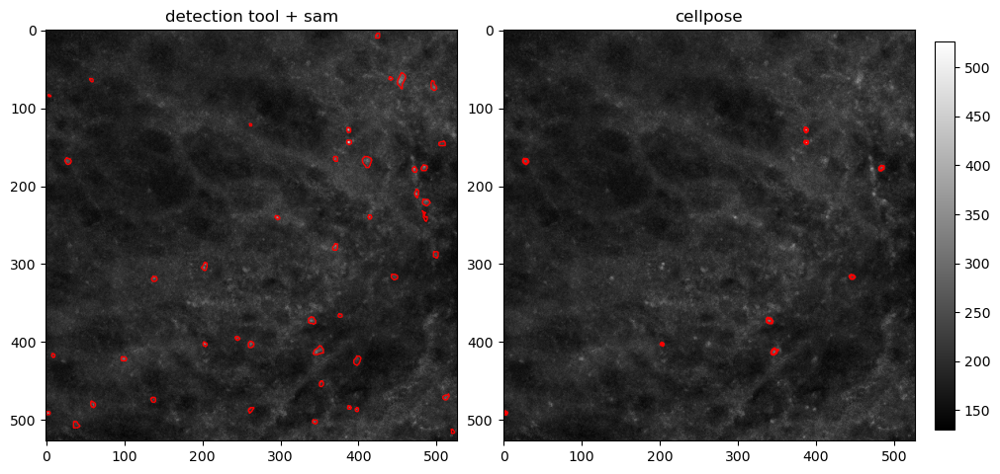

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x0_y1_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
0
1


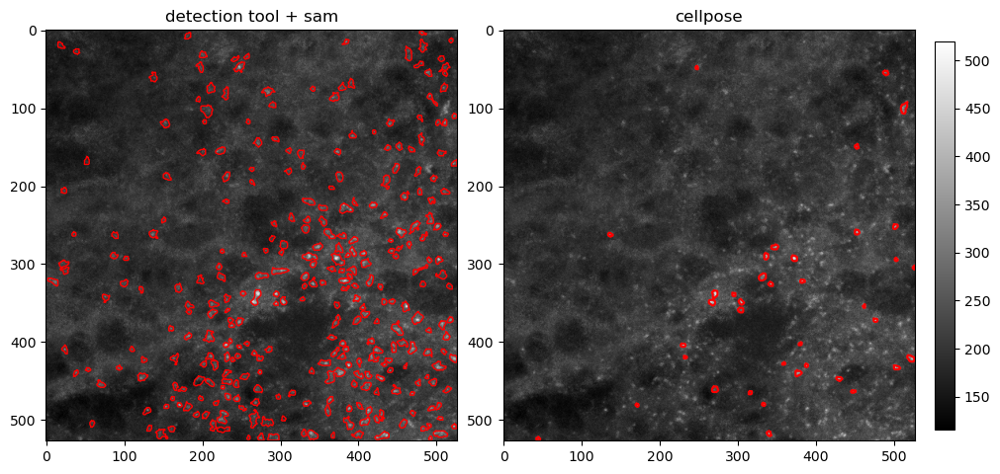

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x0_y2_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
0
2


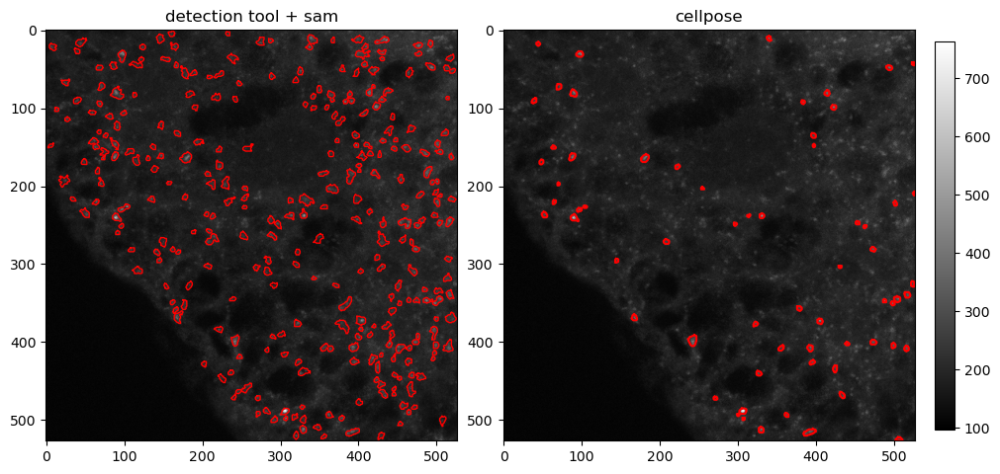

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x0_y3_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
0
3


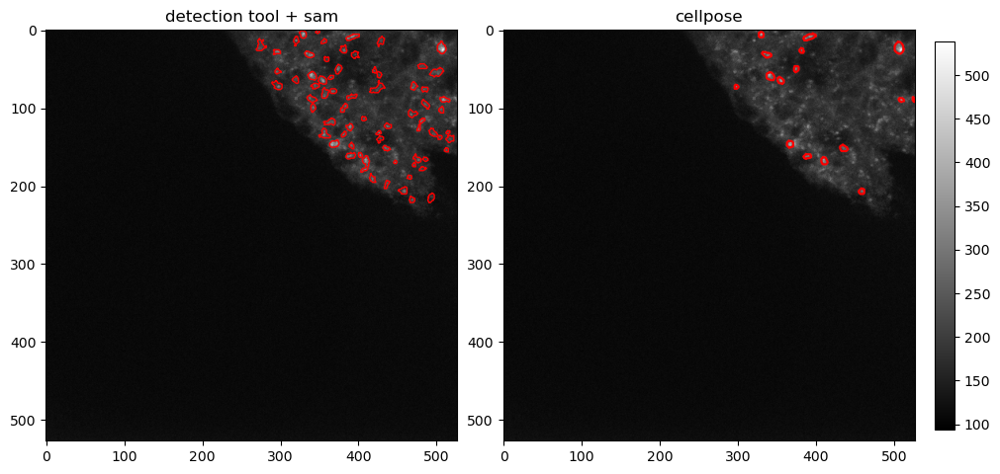

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x1_y0_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
1
0


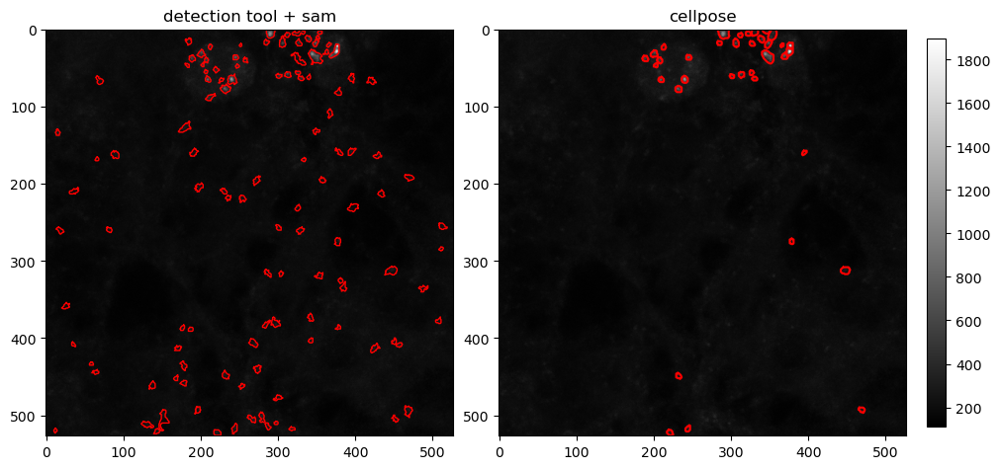

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x1_y1_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
1
1


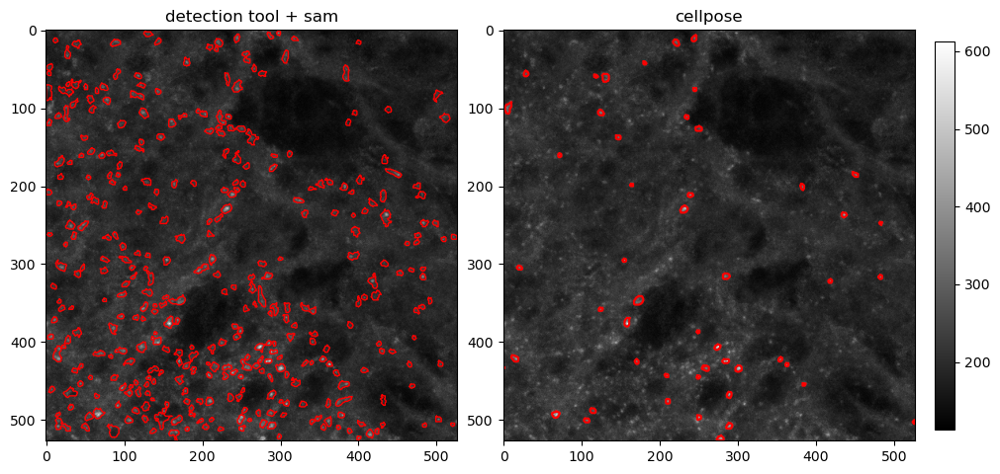

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x1_y2_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
1
2


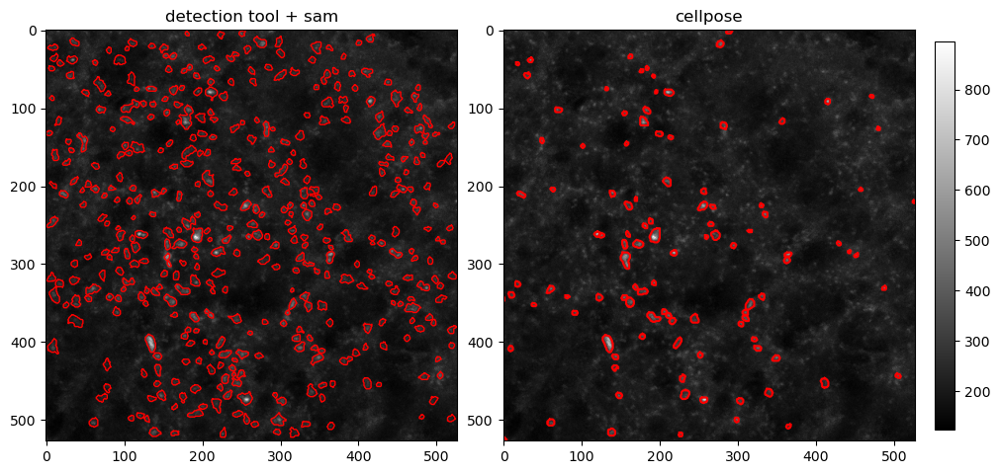

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x1_y3_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
1
3


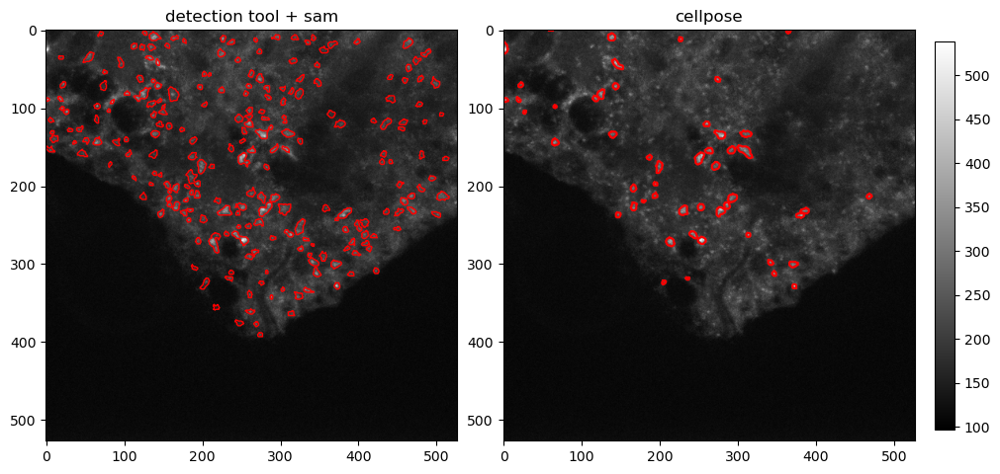

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x2_y0_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
2
0


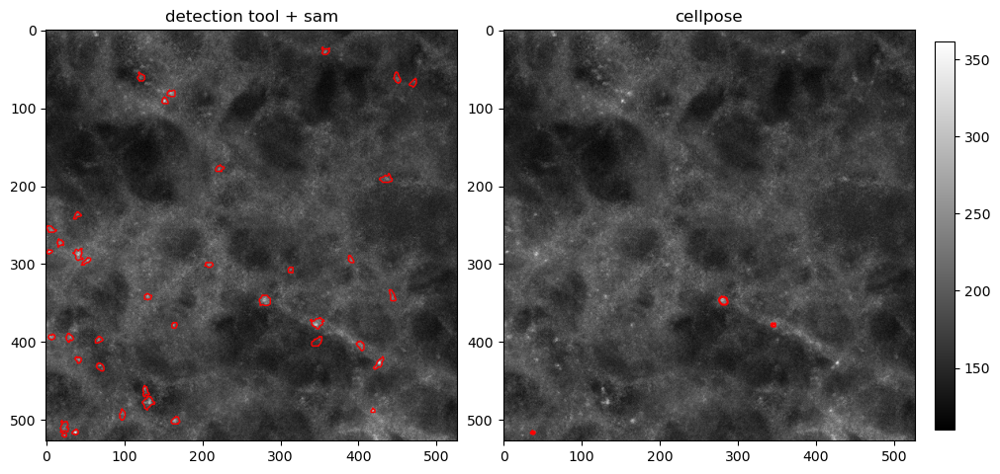

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x2_y1_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
2
1


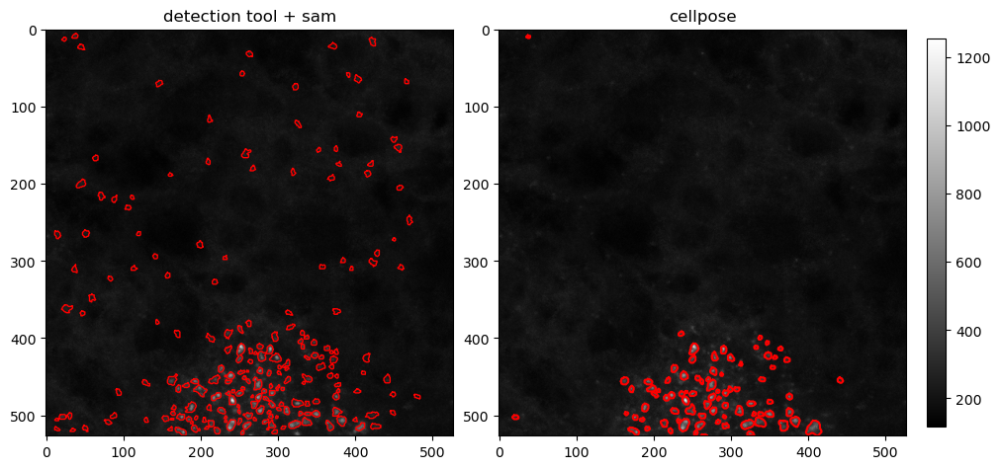

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x2_y2_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
2
2


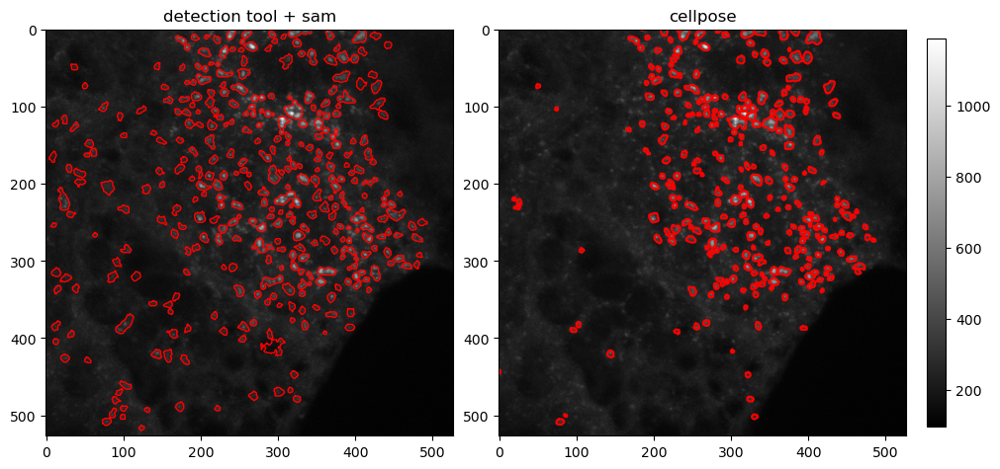

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x2_y3_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
2
3


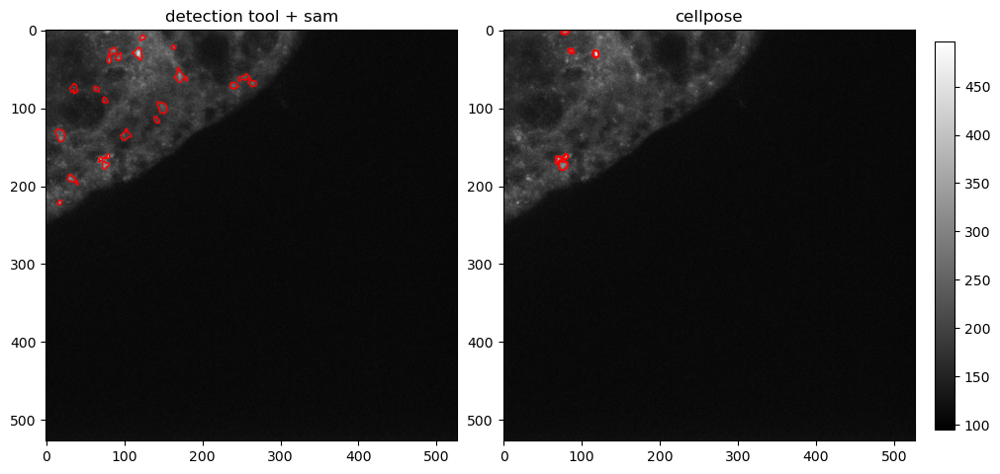

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x3_y0_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
3
0


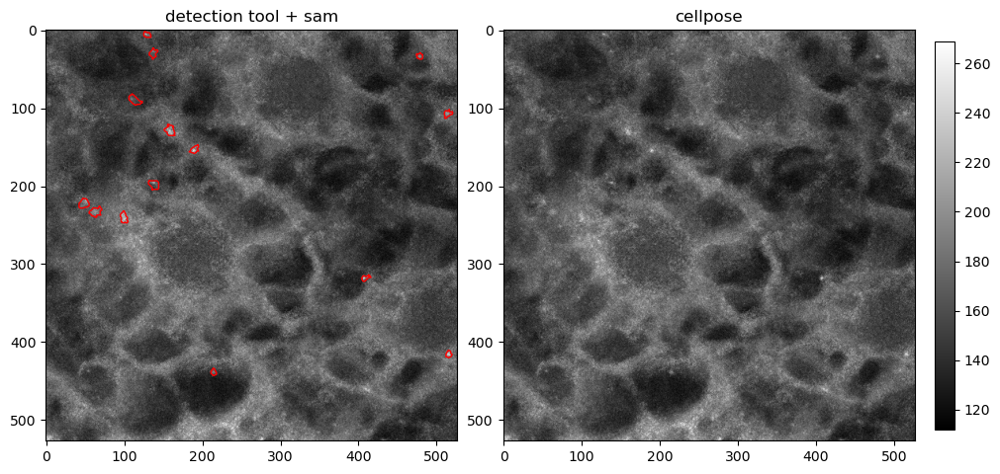

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x3_y1_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
3
1


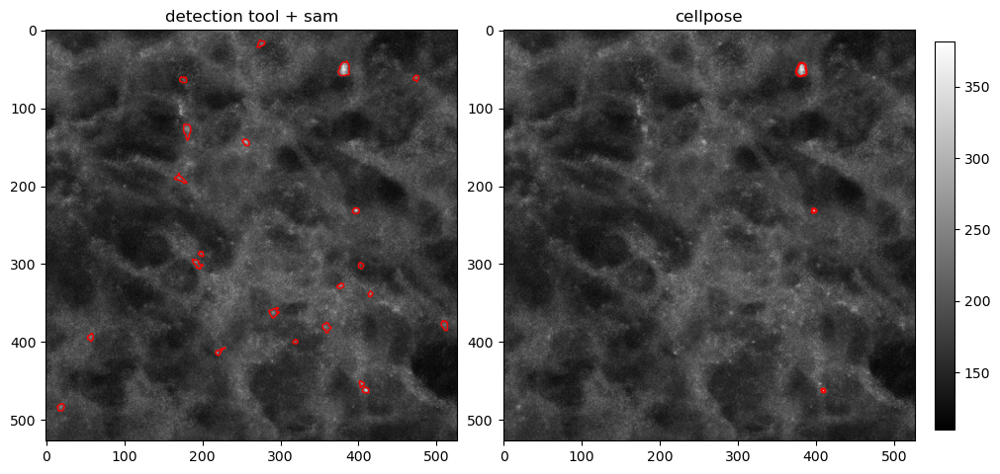

<tifffile.TiffFile 'MF_MaxIP_3ch_2_0…44_84_F_XY1.tif'> OME series cannot handle discontiguous storage ((2048, 2048, 3) != (3, 2048, 2048))


MF_MaxIP_3ch_2_000_230623_544_84_F_XY1_x3_y2_masks.png
/mnt/c/Users/Frieda/Desktop/Master/spot_segmentation/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif
3
2


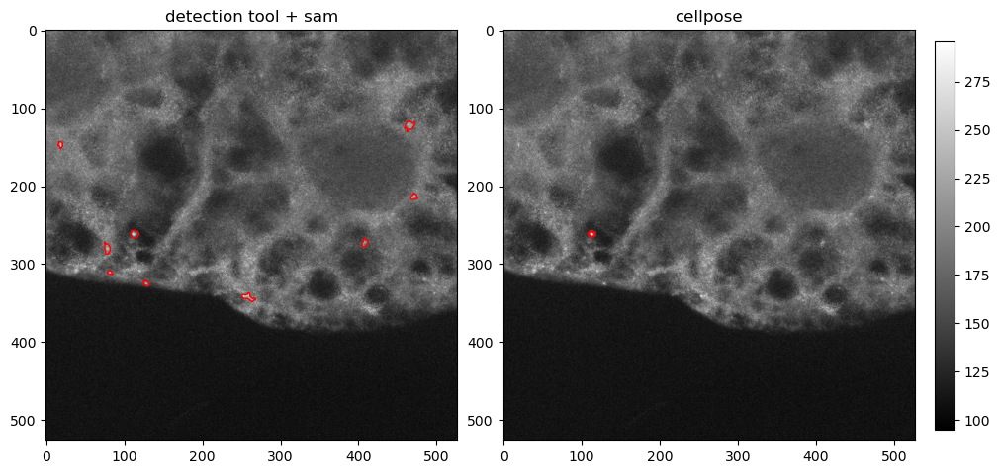

In [65]:
# plot cellpose

image_path = "finetuning/images" 
masks_dir = "finetuning/masks"


for filename in os.listdir(masks_dir):
    cwd = os.getcwd()
    print(filename)
    image_name = filename[:-10] + '.tiff'
    
    image_path = 'finetuning/images/' + image_name
    mask_path = cwd + '/finetuning/masks/' + filename
    img = tiff_to_array(image_path)
    mask_img = cv2.imread(mask_path)
   # cellpose_path = 'cellpose_siri/' + filename[:-15] + '.tif'
    
    cellpose_path = cwd + "/cellpose_siri/MF_MaxIP_3ch_2_000_230623_544_84_F_XY1.tif"# + filename[:-15] + '.tif'
    print(cellpose_path)
    #img_cellpose = cv2.imread(cellpose_path)
    img_cellpose = io.imread(cellpose_path)
    
# file_path = folder_path + image_name

# img = io.imread(file_path)
# mask = cv2.imread(
    # img = img[:,:,0]
    start_x = int(filename[-14])
    start_y = int(filename[-11])

    x_start = img.shape[0] *start_x - 20 * start_x
    y_start = img.shape[0] *start_y - 20 * start_y

    #img_cellpose_cropped = img_cellpose[x_start:x_start+img.shape[0], y_start:y_start +img.shape[0]]
    img_cellpose_cropped = img_cellpose[y_start:y_start +img.shape[0], x_start:x_start+img.shape[0]]
    dat_path = cellpose_path[:-4] + '_seg.npy'
    dat = np.load(dat_path, allow_pickle=True).item()
    # plot image with masks overlaid
    mask_RGB = plot.mask_overlay(img_cellpose[:,:,1], dat['masks'],
                            colors=np.array(dat['colors']))
    
    # plot image with outlines overlaid in red
   # dat_cropped = dat['masks'][x_start:x_start+img.shape[0],y_start :y_start+img.shape[0]]
    dat_cropped = dat['masks'][y_start :y_start+img.shape[0], x_start:x_start+img.shape[0]]
    outlines = utils.outlines_list(dat_cropped)
    #outlines = utils.outlines_list(dat)
    
    # plot image without mask
    #plt.rcParams['figure.figsize'] = [10, 10] 
    #plt.imshow(img, cmap='gray')

    # plot comparison
    plt.rcParams['figure.figsize'] = [10, 5] 
    fig, axes = plt.subplots(nrows=1, ncols=2, constrained_layout=True)
    
    im1 = axes[0].imshow(img, cmap='gray')
    contours, _ = cv2.findContours(np.uint8(mask_img[:,:,0]), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for contour in contours:
        contour = contour.squeeze()
        contour = np.vstack([contour, contour[0]]) # close contours
        axes[0].plot(contour[:, 0], contour[:, 1], 'r-', linewidth=1)
    
    im2 = axes[1].imshow(img_cellpose_cropped[:,:,1], cmap='gray')
    for o in outlines: 
        #plt.plot(o[:,0], o[:,1], color='r')
        axes[1].plot(o[:,0], o[:,1], color='r')
    
    cbar = fig.colorbar(im1, ax=axes[1], shrink = 0.8)
    
    axes[0].set_title('detection tool + sam')
    axes[1].set_title('cellpose')
    plt.show()
    # cv2.imwrite("test_mask.png", mask) 



### Results from a quick finetuning using SAM2 and a few random input points
- Only train and validation sets, when done properly should have a test set
- The patches were scaled down even further because of memory issues (many spots per image), here i used 50*50 pixels

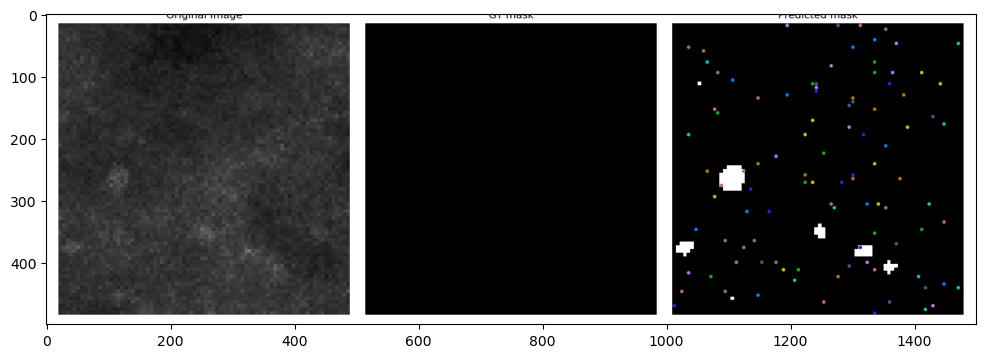

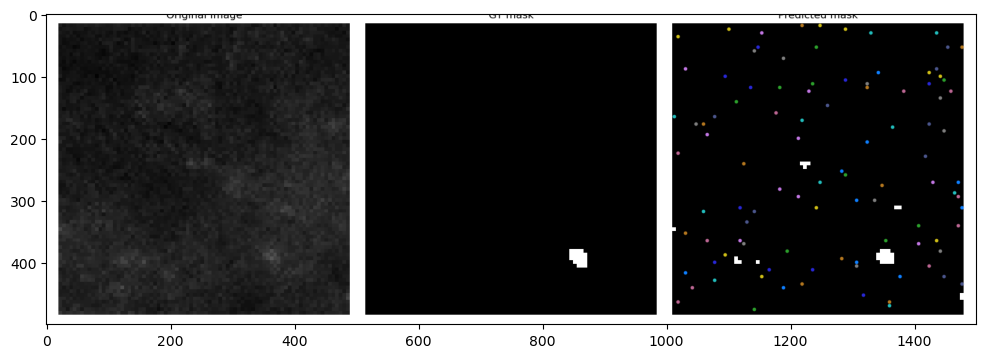

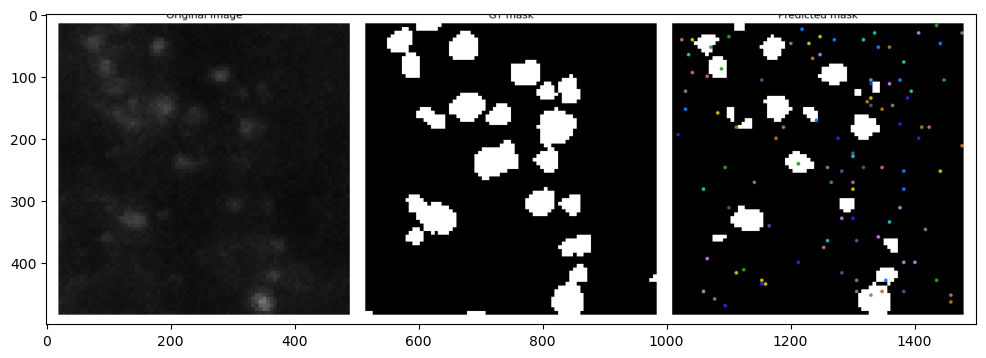

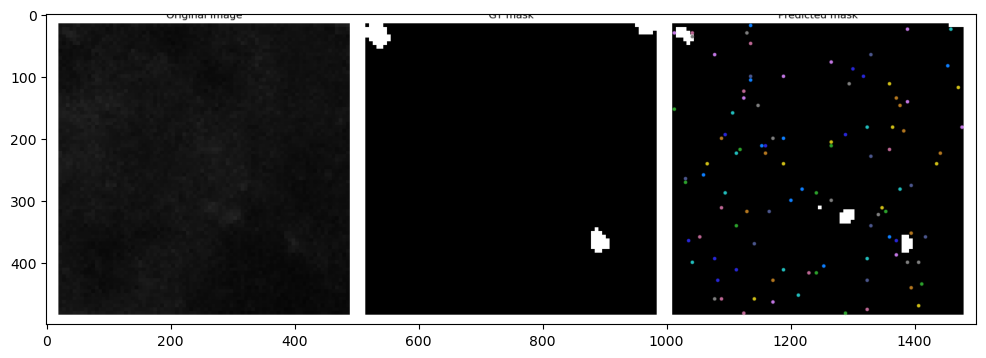

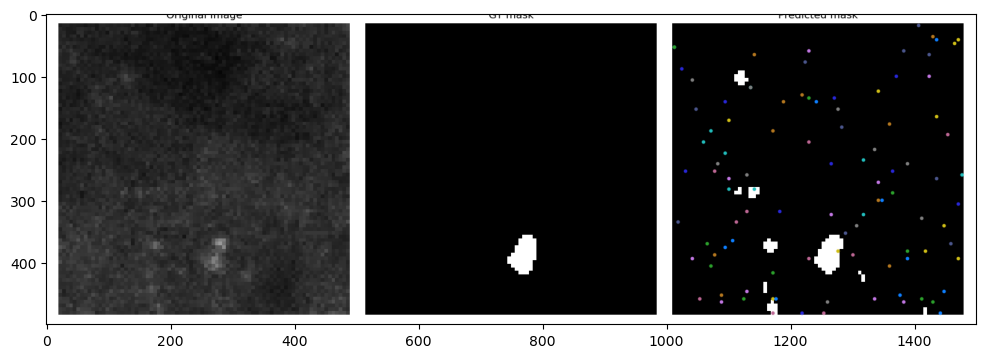

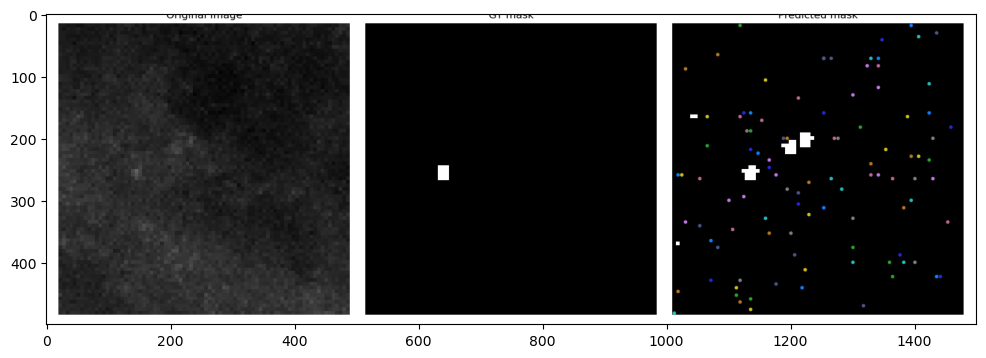

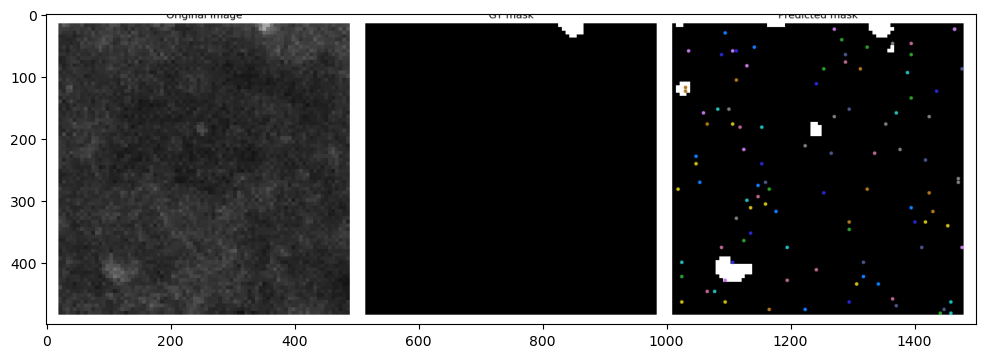

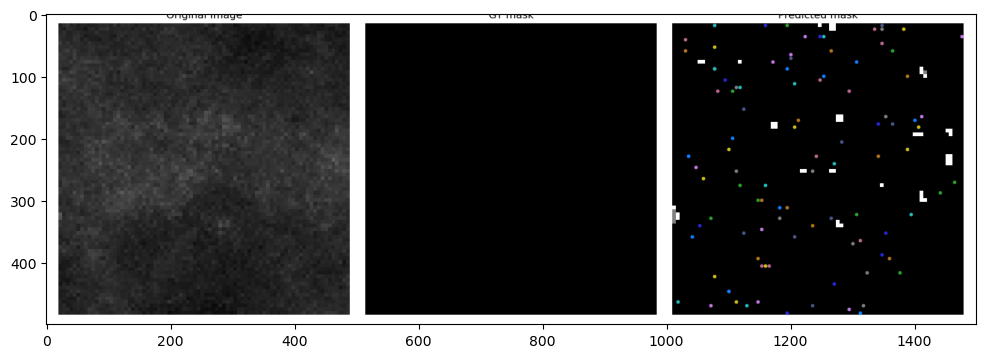

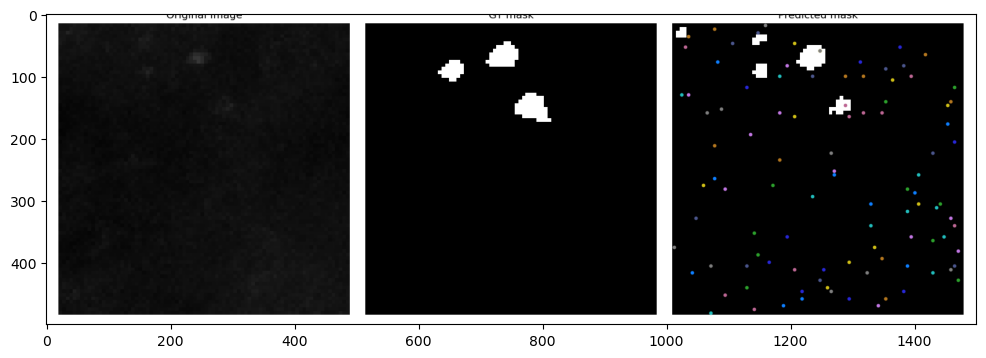

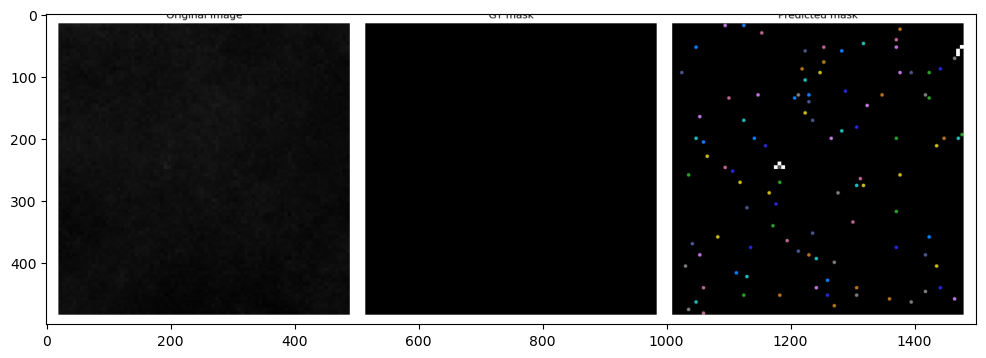

In [13]:
seg_dir = 'test_seg/random_points/'
for filename in os.listdir(seg_dir):
    img_path = 'test_seg/random_points/' + filename
    seg_img = cv2.imread(img_path)
    plt.figure(figsize = (12,5))
    plt.imshow(seg_img)